In [1]:
from matplotlib import pyplot as plt
from matplotlib import cm
import seaborn as sns
from itertools import cycle
import umap
import hdbscan

import numpy as np
import pandas as pd
from collections import Counter
from scipy.stats import fisher_exact
from numpy.random import default_rng
import scipy.stats

import warnings
warnings.filterwarnings('ignore')

from sklearn.manifold import TSNE

import time
import pickle

from enum import IntEnum
class toIntEnum(IntEnum):
    MED12 = 0
    HMGA2 = 1
    UNK = 2
    HMGA1 = 3
    OM = 4
    YEATS4 = 5
    
sns.set(style='white', context='poster', rc={'figure.figsize':(14,10)})


def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), scipy.stats.sem(a)
    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h

class Cluster:

    def __init__(self, label,cont_table,odds_ratio):
        self.label = label
        self.cont_table = cont_table
        self.odds_ratio = odds_ratio
        
        
def plot_random_tiles(df,n_tiles):
    plt.figure(figsize=(8, 12),dpi=120)
    i= 0
    rng = default_rng()
    for n in rng.choice(len(df), size=n_tiles, replace=False):
        ax = plt.subplot(3, 2, i + 1)
        plt.imshow(plt.imread(df['Path'][n])) 
        plt.title(
            df['Sample'][n] + ': ' + toIntEnum(df['Label'][n]).name,
                 fontsize=15)
        plt.axis("off")
        i+=1
    return

def plot_umap(data_umap, metadata, clustered):    
    target_names = ['MED12', 'HMGA2', 'UNK', 'HMGA1', 'OM', 'YEATS4']
    n_classes = len(target_names)
    colors = cycle(["aqua", "darkorange", "cornflowerblue",'violet','red','gold'])

    
    fig, (ax1, ax2) = plt.subplots(1, 2)

    ax1.scatter(data_umap[~clustered, 0],
                data_umap[~clustered, 1],
                color=(0.5, 0.5, 0.5),
                s=0.5,
                alpha=0.7)
    scatter = ax1.scatter(data_umap[clustered, 0],
                data_umap[clustered, 1],
                c=labels[clustered],
                s=0.7,
                cmap='Spectral');

    legend1 = ax1.legend(*scatter.legend_elements(),
                        loc="lower right", title="Clusters",prop={'size':15},markerscale=1)
    ax1.add_artist(legend1)

    for i, color in zip(range(n_classes), colors):
        ax2.scatter(
            data_umap[metadata[metadata['Label']==i].index][:,0],
            data_umap[metadata[metadata['Label']==i].index][:,1],
            color=color,
            label=target_names[i],
            s=0.5,
            alpha=0.7
        )
    ax1.set_title('HDBSCAN clustering of UMAP embedding')
    ax2.set_title('Original labels on UMAP embedding')
    ax2.legend(loc="lower right",prop={'size': 15},markerscale=20,title='Class')
    fig.set_size_inches(20,12)
    fig.set_dpi(300)
    plt.tight_layout()
    fig.suptitle('Fold ' +which_fold.split('_')[1] + ' side-by-side UMAP')

    plt.tight_layout()

def download_results(sheet_list,folds):    
    results = pd.DataFrame()
    for sheet,which_fold in zip(sheet_list,folds):
        fold_res = pd.read_csv('/lustre/scratch/kiviaho/myoma/myoma-new/'+sheet)
        tfrecord_contents = pd.read_csv('/lustre/scratch/kiviaho/myoma/myoma-new/'+which_fold+'_tfr_contents.tsv')
        tfrecord_contents = tfrecord_contents[:len(fold_res)]

        fold_res = fold_res.rename(columns={'0': 0, '1': 1,'2': 2,'3': 3,'4': 4,'5': 5})
        fold_res = pd.concat([tfrecord_contents.reset_index(drop=True), fold_res], axis=1)
        results = pd.concat([fold_res.reset_index(drop=True), results.reset_index(drop=True)])
        results.dropna(inplace=True)
    return results
    
    

/home/ak431480/.conda/envs/myoma-new-env/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
which_fold = 'fold_3'
metadata = pd.read_csv('/lustre/scratch/kiviaho/myoma/myoma-new/conv2d_93_layers/'+which_fold+'_confidently_predicted.tsv',sep='\t')
labels = np.load('/lustre/scratch/kiviaho/myoma/myoma-new/subclass-features/umap/HDBSCAN_on_UMAP_labels_10_dimensions_'+which_fold+'_30_neighbors_0.0_cosine_distance.npy')
data_umap = np.load('/lustre/scratch/kiviaho/myoma/myoma-new/subclass-features/umap/UMAP_visualization_data_2_dims'+which_fold+'_30_neighbors_0.0_cosine_distance_dimensions.npy')
save_path = '/lustre/scratch/kiviaho/myoma/myoma-new/subclass-features/'


In [3]:
if which_fold == 'fold_3' or which_fold == 'fold_4' or which_fold == 'fold_5':
    rng = default_rng(seed=42)
    idxs = rng.choice(len(metadata), size=400000, replace=False)
    metadata = metadata.iloc[idxs].reset_index(drop=True)

In [4]:
metadata['umap_x'] = data_umap[:,0]
metadata['umap_y'] = data_umap[:,1]
metadata['cluster'] = labels

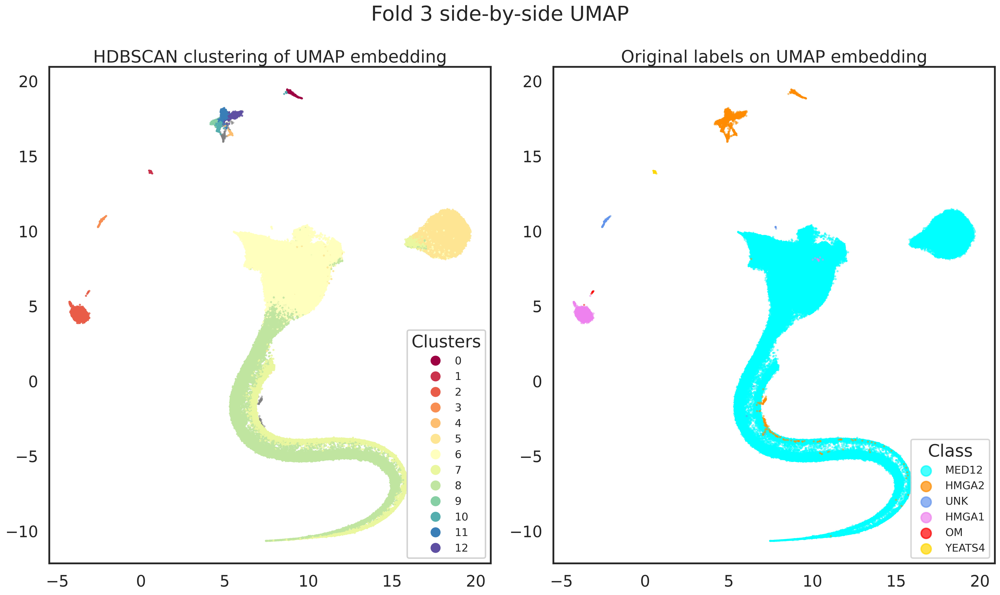

In [5]:
clustered = (labels >= 0)
plot_umap(data_umap,metadata,clustered)

In [6]:
clusters_with_params = dict()

or_thr = 10
p_thr = 0.01

clusters = np.unique(metadata['cluster'])
clusters = np.delete(clusters,np.where(clusters == -1))

counts_all = Counter(metadata['Label'])


In [7]:
for c_idx in clusters:
    df = metadata[metadata['cluster'] == c_idx]
    counts_cluster = Counter(df['Label'])
    cluster_top_label = max(counts_cluster, key=counts_cluster.get)
    a = len(metadata) - counts_all[cluster_top_label]
    b = len(df) - counts_cluster[cluster_top_label]
    c = counts_all[cluster_top_label]
    d = counts_cluster[cluster_top_label]

    cont_table = np.array([[a,b],[c,d]])
    fshr_res = fisher_exact(cont_table)
    cluster_inst = Cluster(cluster_top_label,cont_table,fshr_res[0])    
    clusters_with_params[c_idx] = cluster_inst


In [40]:
i = 0
cluster_type = list()
total_tiles = 0
n_samples_in_cluster = list()
n_tiles_in_cluster = list()
for c in list(clusters_with_params):
    print(c)
    print(toIntEnum(clusters_with_params[c].label).name)
    print(clusters_with_params[c].odds_ratio)
    print('')
    if clusters_with_params[c].odds_ratio >= 10:
        i+=1
        cluster_type.append(toIntEnum(clusters_with_params[c].label).name)
        total_tiles += clusters_with_params[c].cont_table[1,1] # The number of valid tiles in the cluster
        df = metadata[(metadata['cluster'] == c) & (metadata['Label'] == clusters_with_params[c].label)].reset_index()
        n_samples_in_cluster.append(len(np.unique(df['Sample'])))
        n_tiles_in_cluster.append(len(df))
print(str(i)+ '/' + str(len(clusters_with_params)) +' valid clusters with OR > 10')
print('Types of clusters: ' + str(Counter(cluster_type)))
print('{:.2e} total tiles'.format(total_tiles))
print('Number of samples in clusters: ' + str(n_samples_in_cluster))
print('Mean number of samples in clusters: ' + str(np.round(np.mean(n_samples_in_cluster),1)))
print('Number of tiles in clusters: ' + str(n_tiles_in_cluster))
print('Mean number of tiles in clusters: ' + str(np.round(np.mean(n_tiles_in_cluster),1)))
print('')

0
HMGA2
inf

1
YEATS4
inf

2
HMGA1
6197.532559736193

3
UNK
395392.58762886596

4
HMGA2
11540.763322045981

5
MED12
3750.822885767364

6
MED12
737.2852188373067

7
MED12
857.9334344978225

8
MED12
640.48876717441

9
HMGA2
inf

10
HMGA2
inf

11
HMGA2
inf

12
HMGA2
inf

13/13 valid clusters with OR > 10
Types of clusters: Counter({'HMGA2': 6, 'MED12': 4, 'YEATS4': 1, 'HMGA1': 1, 'UNK': 1})
3.99e+05 total tiles
Number of samples in clusters: [2, 1, 9, 9, 2, 35, 53, 35, 51, 3, 6, 8, 5]
Mean number of samples in clusters: 16.8
Number of tiles in clusters: [3809, 1236, 15495, 1927, 507, 76841, 173700, 35152, 78728, 1418, 1509, 4054, 4217]
Mean number of tiles in clusters: 30661.0



In [8]:
clusters = np.arange(0,13)
labs = [1,5,3,2,1,0,0,0,0,1,1,1,1]

In [9]:
cmap = cm.get_cmap('Spectral')

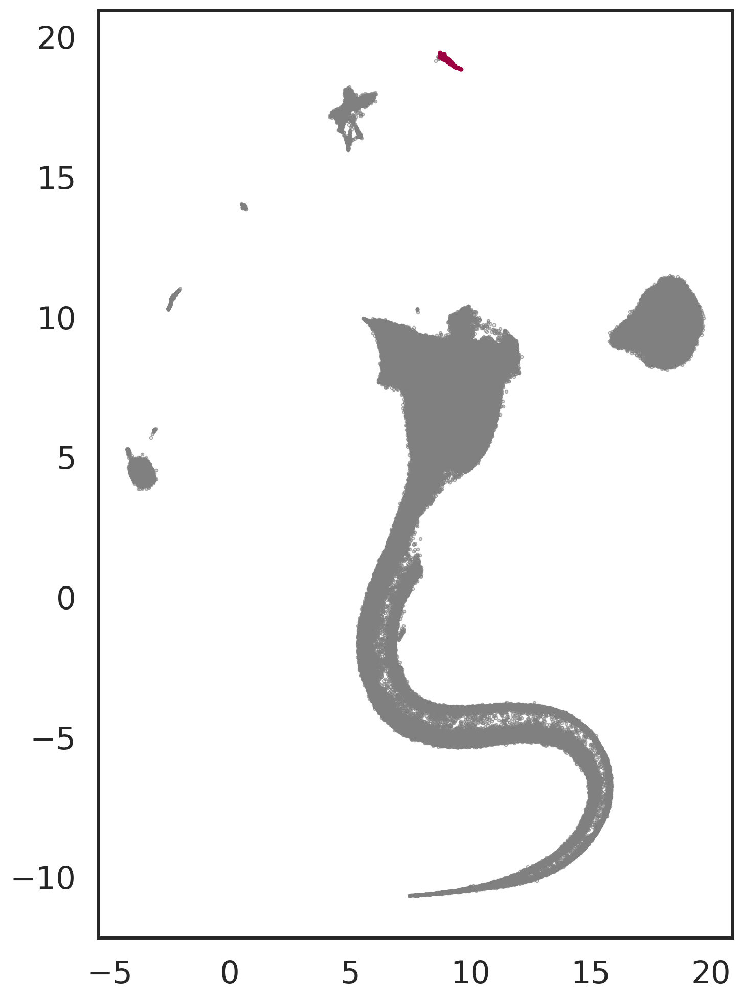

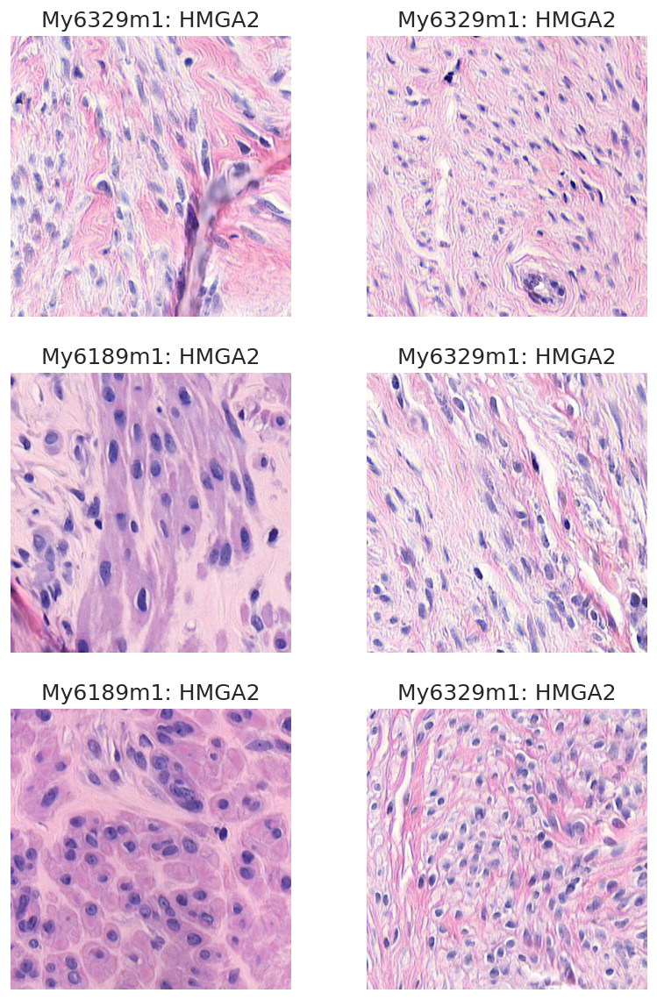

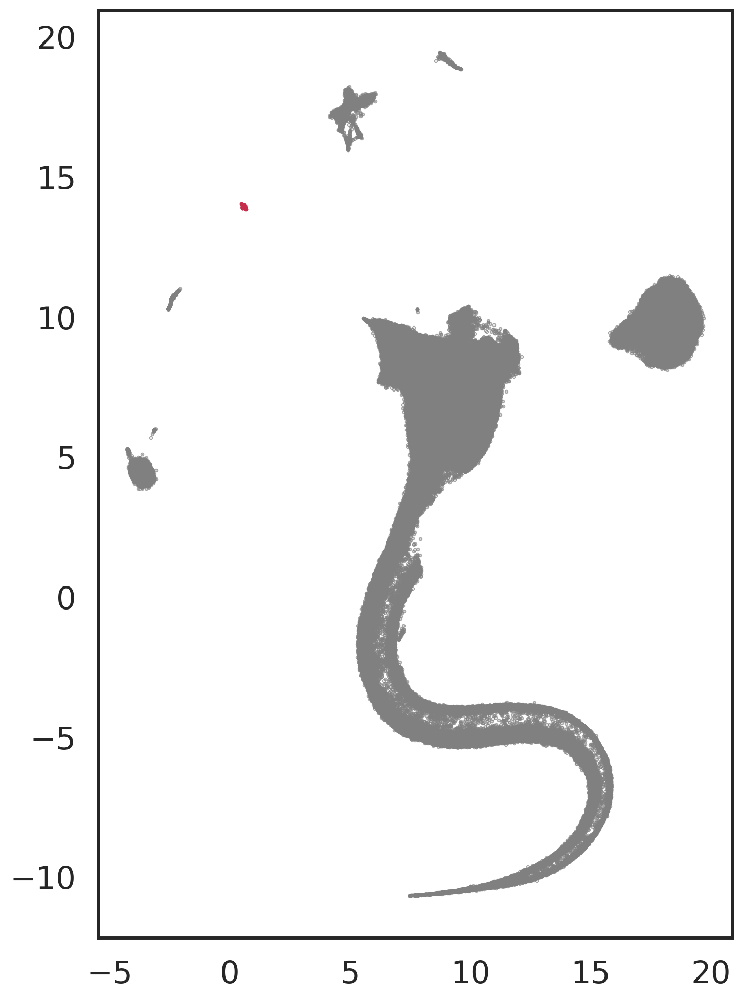

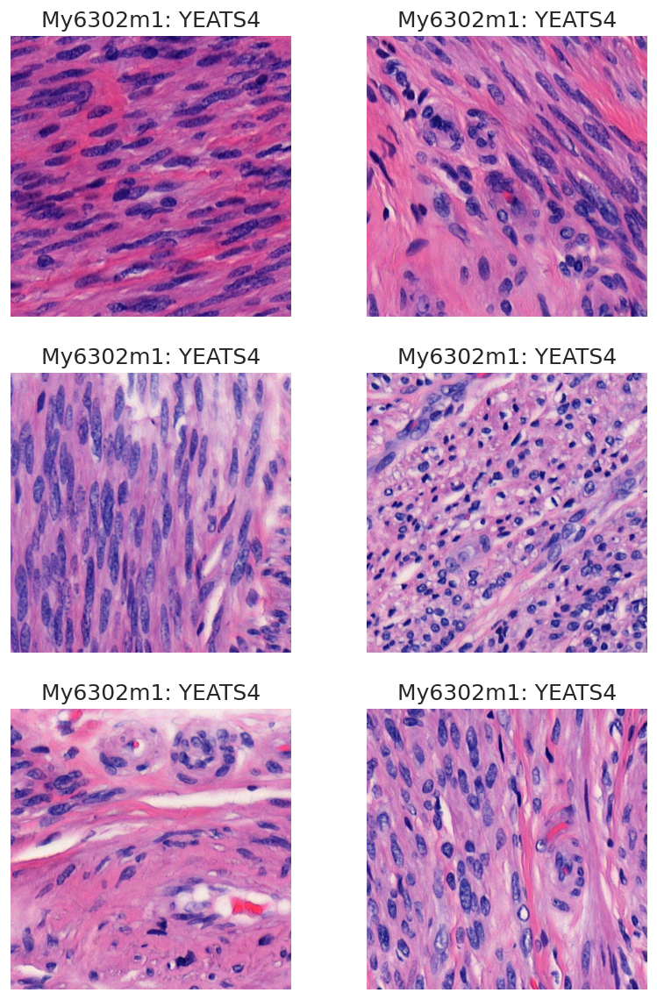

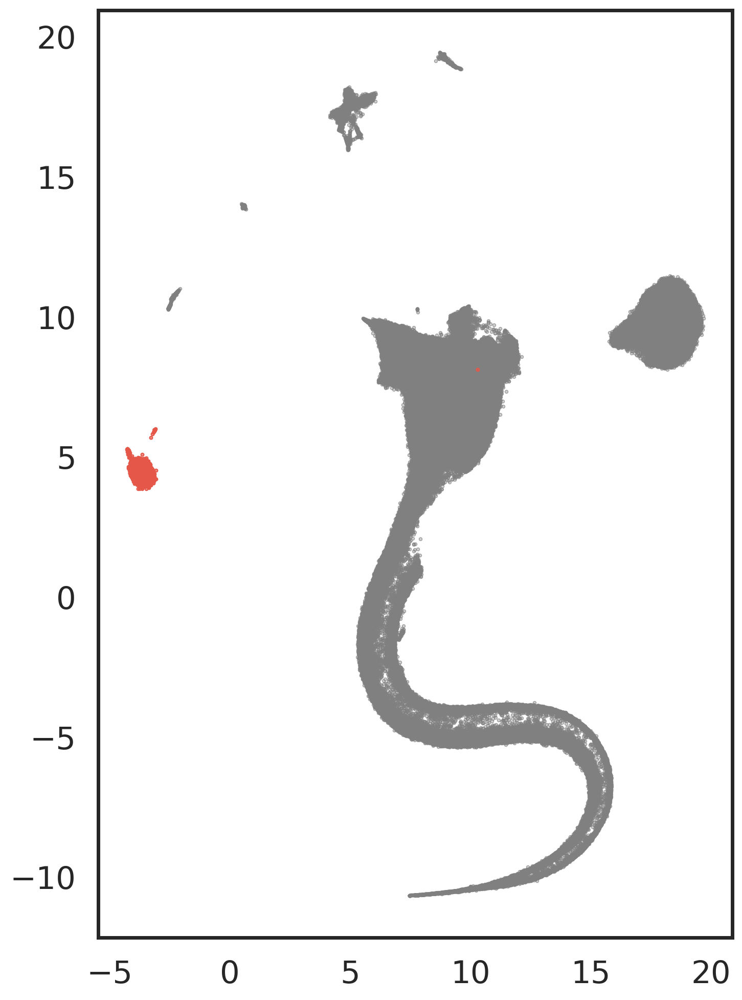

...

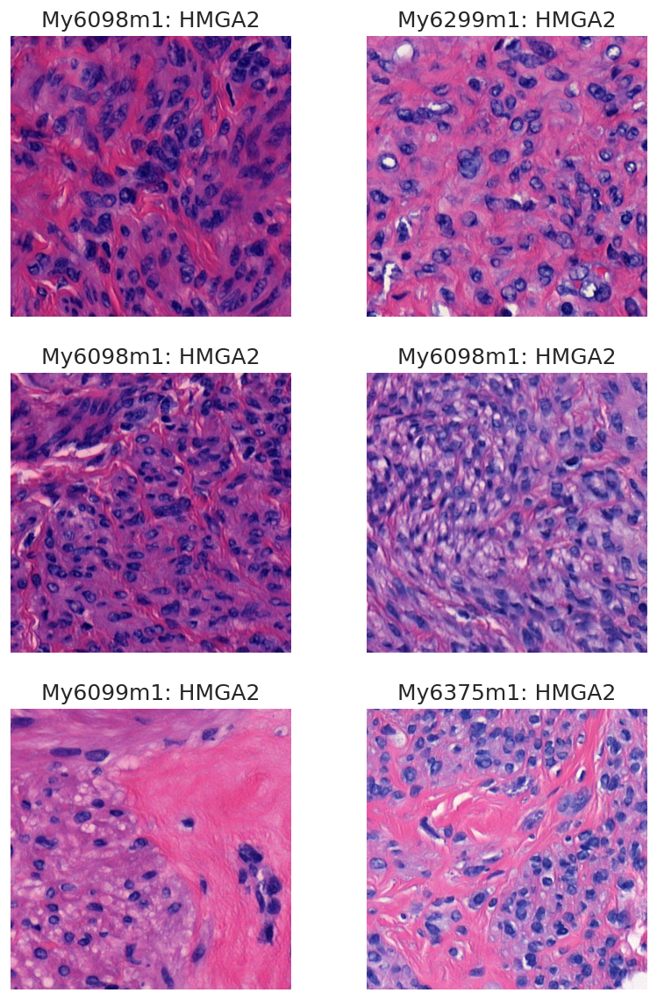

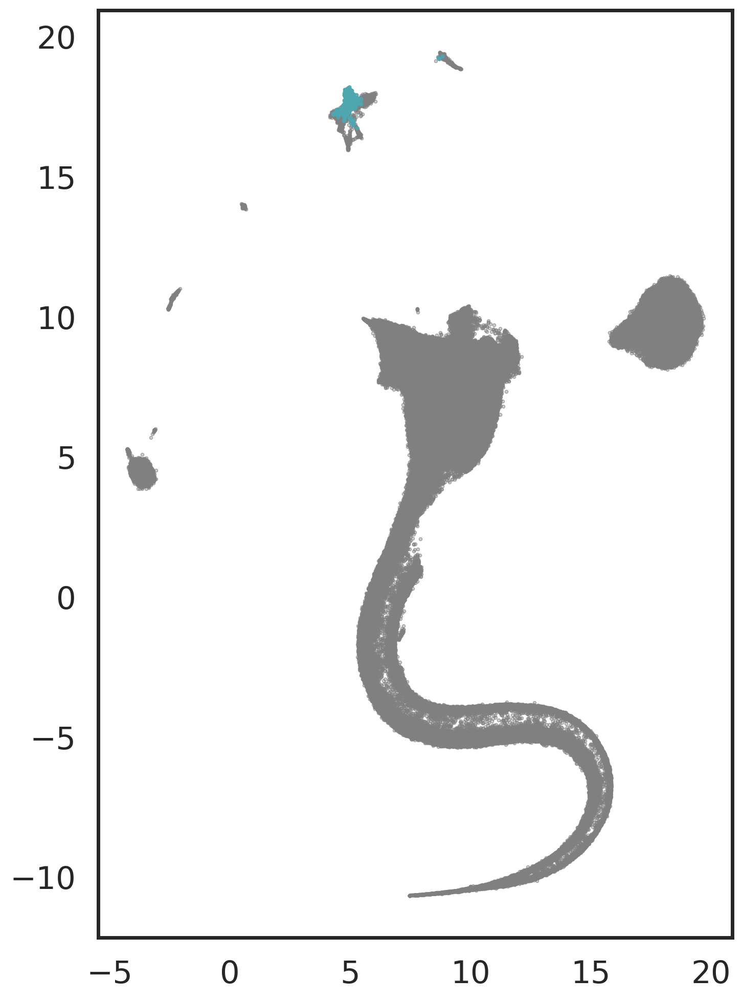

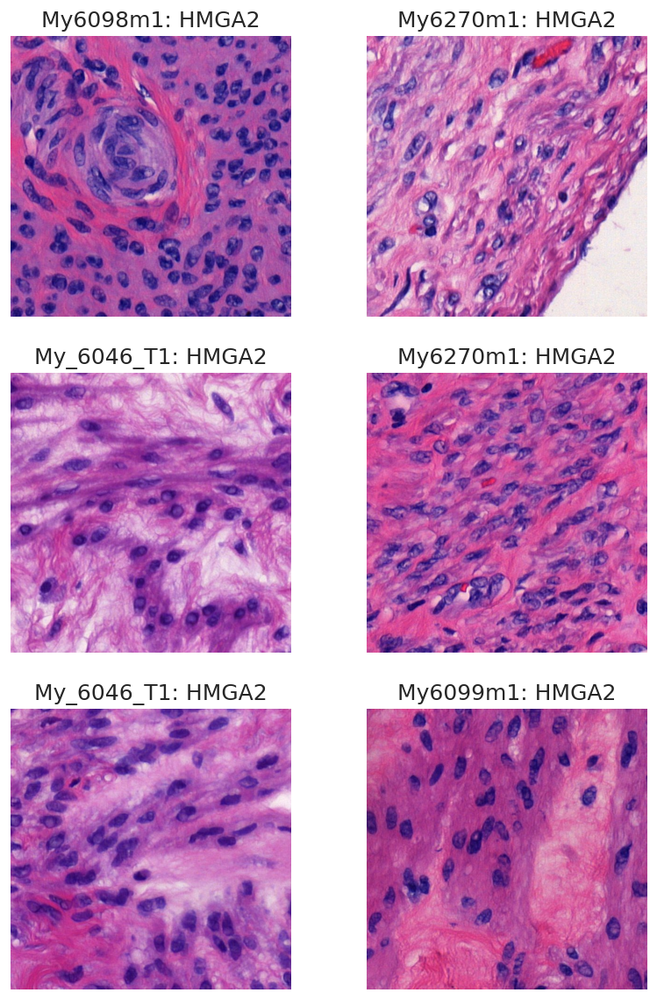

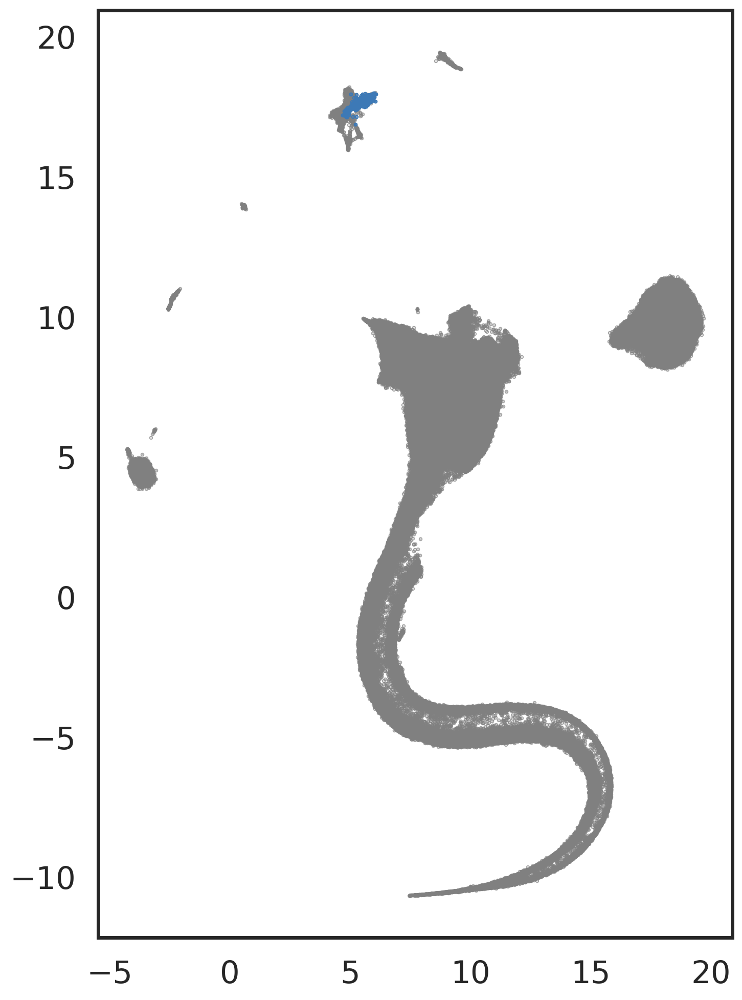

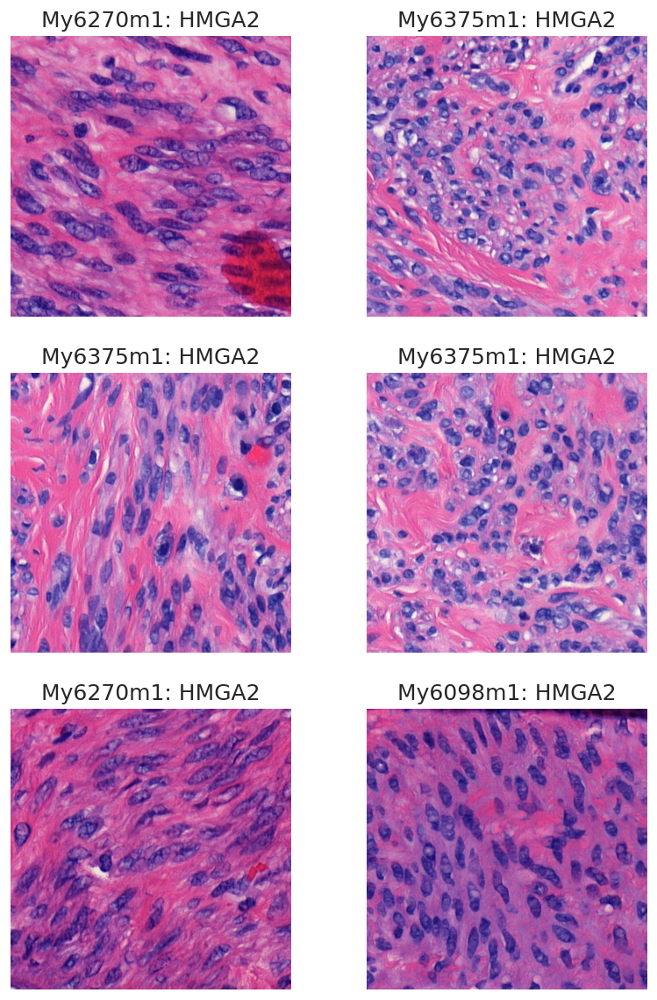

In [88]:
for c,lab in zip(clusters,labs):
    col = cmap(c/len(clusters))
    clustered = np.isin(labels,[c])

    fig,ax1  = plt.subplots(1, 1)

    ax1.scatter(data_umap[~clustered, 0],
                data_umap[~clustered, 1],
                color=(0.5, 0.5, 0.5),
                s=0.5,
                alpha=0.7)
    scatter = ax1.scatter(data_umap[clustered, 0],
                data_umap[clustered, 1],
                #c=labels[clustered],
                color=col,
                s=0.7,
                cmap='Spectral');
    fig.set_size_inches(8,12)
    fig.set_dpi(200)

    plt.savefig(which_fold+'_cluster_'+str(c)+'_'+toIntEnum(lab).name+'_UMAP.png')


    df = metadata[(metadata['cluster'] == c) & (metadata['Label'] == lab)].reset_index()
    balanced_df = pd.DataFrame()
    for s in np.unique(df['Sample']):
        sub_df = df[df['Sample'] == s]
        if len(sub_df) >= 10:
            sub_df = sub_df.sample(n=10,random_state=42)
            balanced_df = pd.concat([sub_df.reset_index(drop=True),balanced_df],ignore_index=True)
        else:
            balanced_df = pd.concat([sub_df.reset_index(drop=True),balanced_df],ignore_index=True)

    plot_random_tiles(balanced_df,6)
    plt.savefig(which_fold+'_cluster_'+str(c)+'_'+toIntEnum(lab).name+'.png')

In [15]:
min([3809, 1236, 15495, 1927, 507, 76841, 173700, 35152, 78728, 1418, 1509, 4054, 4217])

507

In [10]:
valid_clusters = [28, 16, 7, 44, 31, 4, 4, 7, 56, 3, 42, 44,
                  7, 58, 57, 8, 22, 32, 7, 7, 7, 2, 1, 9, 9,
                  2, 35, 53, 35, 51, 3, 6, 8, 5, 2, 6, 25, 55,
                  29, 27, 14, 13, 6, 5, 12, 10, 10, 7, 11, 6, 72,
                  5, 13, 7]
valid_tiles = [60776, 2954, 1772, 9525, 42770, 1516, 1621,
               12855, 87797, 923, 22119, 861, 849, 5590, 5805, 18170, 2250, 29385, 4538, 5283, 4923,
               3809, 1236, 15495, 1927, 507, 76841, 173700, 35152, 78728, 1418, 1509, 4054, 4217,
               21429, 6712, 79352, 182685, 831, 527, 3505, 6198, 4109, 1502, 4488, 1431, 923, 2169, 1991,
               3215, 329031, 776, 14724, 9364]
               

print(mean_confidence_interval(valid_clusters))

print(mean_confidence_interval(valid_tiles))

(19.35185185185185, 14.197754013623113, 24.50594969008059)
(25848.833333333332, 10303.618252472883, 41394.04841419378)


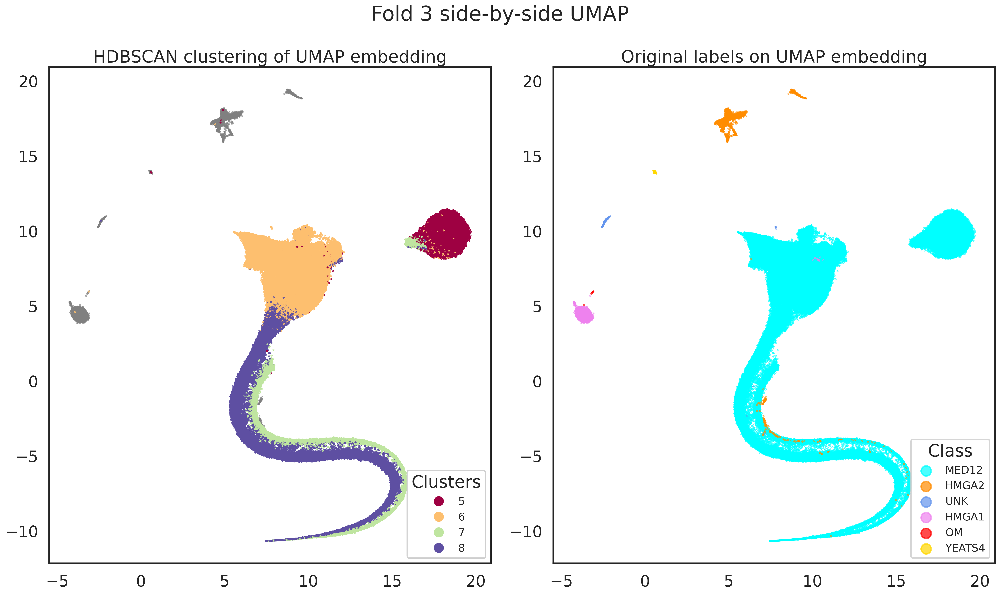

In [42]:
clustered = np.isin(labels,[5,6,7,8])
plot_umap(data_umap,metadata,clustered)

In [10]:
from pathlib import Path
import subprocess

In [16]:
save_path = '/lustre/scratch/kiviaho/myoma/myoma-new/data/confident_predictions/'
for c in list():
    mut = toIntEnum(clusters_with_params[c].label).name
    sample_dir = mut+'_cluster_'+str(c)+'_confident_tiles'
    target_dir = save_path + sample_dir

    # Create the dir
    Path(target_dir).mkdir(parents=True, exist_ok=True)
    
    df = metadata[(metadata['cluster'] == c) & (metadata['Label'] == clusters_with_params[c].label)].reset_index(drop=True)
    
     # Copy randomly selected tiles to target directory
    tiles = []
    for tile in df['Path']:
        cmd = ['cp',tile,target_dir]
        subprocess.Popen(cmd)
        
        s = tile.split('/')
        tiles.append(sample_dir+'/'+s[len(s)-1])

    df = df.rename(columns = {'Path':'Tile'})
    df['Tile'] = tiles
    
    df.to_csv(save_path+sample_dir+'_metadata.tsv',index=False,sep ='\t')
    print('Cluster ' + str(c) + ' done!')
    

Cluster 6 done!


In [22]:
from os.path import exists
meta = pd.read_csv(save_path+'MED12_cluster_6_confident_tiles_metadata.tsv',sep='\t')

In [23]:
valid_files = []
for p in meta['Tile']:
    if exists(save_path+p):
        valid_files.append(p)

In [ ]:
# ALL BELOW CAN BE USED TO EXTRACT SUBSETS OF THE LARGER SAMPLE SETS:

In [3]:
from pathlib import Path
import subprocess
from os.path import exists
import pandas as pd

In [6]:
sample_dir = 'MED12_cluster_8_confident_tiles'

df = pd.read_csv('/lustre/scratch/kiviaho/myoma/myoma-new/data/confident_predictions/'+sample_dir+'_metadata.tsv',sep='\t')
df_subset = df.sample(n=10000,random_state=234234)
save_path = '/lustre/scratch/kiviaho/myoma/myoma-new/hovernet/data/'

target_dir = save_path + sample_dir + '_subsample'
Path(target_dir).mkdir(parents=True, exist_ok=True)
df_subset.to_csv(save_path+sample_dir+'_metadata.csv')


In [7]:
tile_path = '/lustre/scratch/kiviaho/myoma/myoma-new/data/confident_predictions/'
for tile in df_subset['Tile']:
        cmd = ['cp',tile_path+tile,target_dir]
        subprocess.Popen(cmd)